<a href="https://colab.research.google.com/github/shahdmedhat/Goodreads/blob/main/Copy_of_Milestone_1_template(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*Member 1*

Name: Shahd Medhat

ID: 46-1105

*Member 2*

Name: Amira Hossam ElDin Roshdy

ID: 46-1073

*Member 3*

Name: Mohanad Osama

ID: 46-2021

*Member 4*

Name: Hossam Magdy Mohamed

ID: 46-2935


# Milestone 1 - EDA and Preprocessing data 

- Load dataset
- Explore the dataset and ask atleast 5 questions to give you a better understanding of the data provided to you. 
- Visualise the answer to these 5 questions.
- Cleaing the data
- Observe missing data and comment on why you believe it is missing(MCAR,MAR or MNAR) 
- Observe duplicate data
- Observe outliers
- After observing outliers,missing data and duplicates, handle any unclean data.
- With every change you are making to the data you need to comment on why you used this technique and how has it affected the data(by both showing the change in the data i.e change in number of rows/columns,change in distrubution, etc and commenting on it).
- Data transformation and feature engineering
- Add a new column named 'Week number' and discretisize the data into weeks according to the dates.Tip: Change the datatype of the date feature to datetime type instead of object.
- Encode any categorical feature(s) and comment on why you used this technique and how the data has changed.
- Identify feature(s) which need normalisation and show your reasoning.Then choose a technique to normalise the feature(s) and comment on why you chose this technique.
- Add atleast two more columns which adds more info to the dataset by evaluating specific feature(s). I.E( Column indicating whether the accident was on a weekend or not). 
- For any imputation with arbitrary values or encoding done, you have to store what the value imputed or encoded represents in a new csv file. I.e if you impute a missing value with -1 or 100 you must have a csv file illustrating what -1 and 100 means. Or for instance, if you encode cities with 1,2,3,4,etc what each number represents must be shown in the new csv file.
- Load the new dataset into a csv file.
- **Extremely Important note** - Your code should be as generic as possible and not hard-coded and be able to work with various datasets. Any hard-coded solutions will be severely penalised.
- Bonus: Load the dataset as a parquet file instead of a csv file(Parquet file is a compressed file format).

# Q1: When do accidents usually happen? (weekends or weekdays?)

# Q2: Which areas have the most accidents? (longitude and latitude)

# Q3: How many severe accidents happened in 2010?

# Q4: Do accidents happen more in daylight or night-time?

# Q5: Which weather conditions affect the accidents' rate more? (weather or road condition)

# 1 - Extraction

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
from sklearn import preprocessing
import csv

In [2]:
from pandas.api.types import is_numeric_dtype

In [3]:
!pip install geoplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame

In [6]:
dataset = pd.read_csv('/content/dataset/2010_Accidents_UK.csv')
print(dataset)

       accident_index  accident_year accident_reference  \
0       201001BS70003           2010          01BS70003   
1       201001BS70004           2010          01BS70004   
2       201001BS70006           2010          01BS70006   
3       201001BS70007           2010          01BS70007   
4       201001BS70008           2010          01BS70008   
...               ...            ...                ...   
154409  2010984142510           2010          984142510   
154410  2010984143110           2010          984143110   
154411  2010984144210           2010          984144210   
154412  2010984144310           2010          984144310   
154413  2010984144410           2010          984144410   

        location_easting_osgr  location_northing_osgr  longitude   latitude  \
0                    527580.0                177730.0  -0.164002  51.484087   
1                    525340.0                180470.0  -0.195273  51.509212   
2                    524800.0                180300.0 

In [7]:
# Copying the dataset so as not to change the original dataset
datasetCopy = dataset.copy()

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 154414 entries, 0 to 154413
Data columns (total 36 columns):
 #   Column                                       Non-Null Count   Dtype  
---  ------                                       --------------   -----  
 0   accident_index                               154414 non-null  object 
 1   accident_year                                154414 non-null  int64  
 2   accident_reference                           154414 non-null  object 
 3   location_easting_osgr                        154414 non-null  float64
 4   location_northing_osgr                       154414 non-null  float64
 5   longitude                                    154414 non-null  float64
 6   latitude                                     154414 non-null  float64
 7   police_force                                 154414 non-null  object 
 8   accident_severity                            154414 non-null  object 
 9   number_of_vehicles                           154414 non-nul

In [9]:
dataset.dtypes

accident_index                                  object
accident_year                                    int64
accident_reference                              object
location_easting_osgr                          float64
location_northing_osgr                         float64
longitude                                      float64
latitude                                       float64
police_force                                    object
accident_severity                               object
number_of_vehicles                               int64
number_of_casualties                             int64
date                                            object
day_of_week                                     object
time                                            object
local_authority_district                        object
local_authority_ons_district                    object
local_authority_highway                         object
first_road_class                                object
first_road

In [10]:
dataset.describe()

,accident_year,location_easting_osgr,location_northing_osgr,longitude,latitude,number_of_vehicles,number_of_casualties,speed_limit
count,154414.0,154414.000000,1.544140e+05,154414.000000,154414.000000,154414.000000,154414.000000,154414.000000
mean,2010.0,440441.432448,2.989781e+05,-1.424687,52.578706,1.822380,1.351225,38.884266
std,0.0,95250.135356,1.612506e+05,1.400062,1.452032,0.704551,0.823076,14.067157
min,2010.0,64950.000000,1.065000e+04,-7.516225,49.915730,1.000000,1.000000,10.000000
25%,2010.0,376520.000000,1.783900e+05,-2.353217,51.491093,1.000000,1.000000,30.000000
50%,2010.0,442110.000000,2.655100e+05,-1.375859,52.278924,2.000000,1.000000,30.000000
75%,2010.0,523800.000000,3.962700e+05,-0.212073,53.461590,2.000000,1.000000,50.000000
max,2010.0,655370.000000,1.174800e+06,1.759398,60.454772,19.000000,43.000000,70.000000


In [11]:
dataset.describe(include = ['object'])

,accident_index,accident_reference,police_force,accident_severity,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,...,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location
count,154414,154414,154414,154414,154414,154414,154414,154414,154414,154414,...,154414,154414,151685,154414,154414,154414,154414,154414,154414,154414
unique,154414,154414,51,3,365,7,1440,380,381,208,...,6,5,9,6,8,6,2,2,3,29332
top,201001BS70003,01BS70003,Metropolitan Police,Slight,01/10/2010,Friday,17:00,Birmingham,Birmingham,Kent,...,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,-1
freq,1,1,23810,132243,699,25475,1480,2876,2876,4278,...,127434,115281,123396,104475,150479,151624,99488,124402,125801,10307


In [12]:
dataset.head()

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location
0,201001BS70003,2010,01BS70003,527580.0,177730.0,-0.164002,51.484087,Metropolitan Police,Slight,2,...,No physical crossing facilities within 50 metres,Daylight,Other,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002900
1,201001BS70004,2010,01BS70004,525340.0,180470.0,-0.195273,51.509212,Metropolitan Police,Slight,1,...,Pedestrian phase at traffic signal junction,Darkness - lights lit,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002884
2,201001BS70006,2010,01BS70006,524800.0,180300.0,-0.203110,51.507804,Metropolitan Police,Slight,2,...,Pedestrian phase at traffic signal junction,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002871
3,201001BS70007,2010,01BS70007,525080.0,180920.0,-0.198858,51.513314,Metropolitan Police,Slight,2,...,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002886
4,201001BS70008,2010,01BS70008,526760.0,177740.0,-0.175802,51.484361,Metropolitan Police,Slight,2,...,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002845


In [13]:
# Displaying all the columns of the dataset

pd.set_option("max_columns", None) # show all cols
pd.set_option('max_colwidth', None) # show full width of showing cols
pd.set_option("expand_frame_repr", False) # print cols side by side as it's supposed to be
display(dataset)

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location
0,201001BS70003,2010,01BS70003,527580.0,177730.0,-0.164002,51.484087,Metropolitan Police,Slight,2,1,11/01/2010,Monday,07:30,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,B,302,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Other,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002900
1,201001BS70004,2010,01BS70004,525340.0,180470.0,-0.195273,51.509212,Metropolitan Police,Slight,1,1,11/01/2010,Monday,18:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,A,4204.0,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002884
2,201001BS70006,2010,01BS70006,524800.0,180300.0,-0.203110,51.507804,Metropolitan Police,Slight,2,1,12/01/2010,Tuesday,10:22,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,B,450.0,None within 50 metres,Pedestrian phase at traffic signal junction,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002871
3,201001BS70007,2010,01BS70007,525080.0,180920.0,-0.198858,51.513314,Metropolitan Police,Slight,2,1,02/01/2010,Saturday,21:21,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Roundabout,30.0,Mini-roundabout,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002886
4,201001BS70008,2010,01BS70008,526760.0,177740.0,-0.175802,51.484361,Metropolitan Police,Slight,2,1,04/01/2010,Monday,20:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3217,Single carriageway,30.0,Crossroads,Auto traffic signal,A,3220.0,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002845
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154409,2010984142510,2010,984142510,328910.0,568230.0,-3.112969,55.003563,Dumfries and Galloway,Slight,1,1,18/12/2010,Saturday,13:45,Dumfries and Galloway,Dumfries and Galloway,Dumfries & Galloway,C,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Single carriageway,60.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Snowing no high winds,Frost or ice,None,None,Rural,Yes,Data missing or out of range,-1
154410,2010984143110,2010,984143110,322170.0,573610.0,-3.219785,55.050889,Dumfries and Galloway,Slight,1,1,24/12/2010,Friday,02:30,Dumfries and Galloway,Du

In [14]:
dataset.columns

Index(['accident_index', 'accident_year', 'accident_reference',
       'location_easting_osgr', 'location_northing_osgr', 'longitude',
       'latitude', 'police_force', 'accident_severity', 'number_of_vehicles',
       'number_of_casualties', 'date', 'day_of_week', 'time',
       'local_authority_district', 'local_authority_ons_district',
       'local_authority_highway', 'first_road_class', 'first_road_number',
       'road_type', 'speed_limit', 'junction_detail', 'junction_control',
       'second_road_class', 'second_road_number',
       'pedestrian_crossing_human_control',
       'pedestrian_crossing_physical_facilities', 'light_conditions',
       'weather_conditions', 'road_surface_conditions',
       'special_conditions_at_site', 'carriageway_hazards',
       'urban_or_rural_area', 'did_police_officer_attend_scene_of_accident',
       'trunk_road_flag', 'lsoa_of_accident_location'],
      dtype='object')

# 2- EDA

In [15]:
dataset.groupby("day_of_week")["accident_reference"].count()

day_of_week
Friday       25475
Monday       22452
Saturday     20820
Sunday       16794
Thursday     22810
Tuesday      23045
Wednesday    23018
Name: accident_reference, dtype: int64

In [16]:
# Creating a new column called "weekend" to determine if an accident occured on a weekday or during the weekend
weekEnd=[]
for i in dataset['day_of_week']:
  if i == 'Saturday' or i =='Sunday':
    weekEnd.append('Yes')
  else:
    weekEnd.append('No')
datasetCopy['weekend'] = weekEnd

(array([116800.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0.,  37614.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

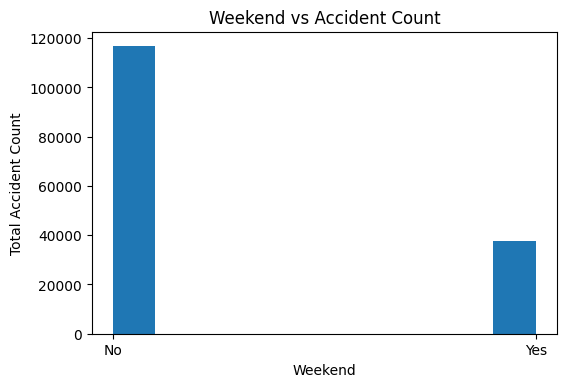

In [17]:
# Q1: When do accidents occur the most (weekends vs weekdays)?

fig, axs_2 = plt.subplots(1,1,dpi=100)
axs_2.set_xlabel('Weekend')
axs_2.set_ylabel('Total Accident Count')
axs_2.set_title('Weekend vs Accident Count')
axs_2.hist(datasetCopy['weekend']) #a numpy array that has the ages of each passenger who survived (all ages not only unique values)

**As the histogram shows, most accidents (around 75%) occured on weekdays.**

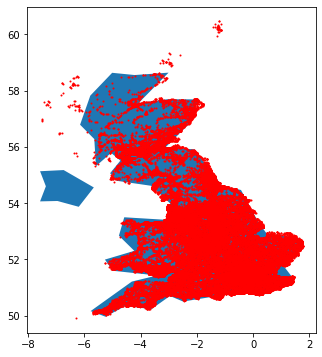

In [18]:
#Q2: Which areas have the most accidents? (longitude and latitude)

geometry = [Point(xy) for xy in zip(dataset['longitude'], dataset['latitude'])]
gdf = GeoDataFrame(dataset, geometry=geometry)   

#this is a simple map that goes with geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
# gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15);
gdf.plot(ax= world[(world.name == "United Kingdom")].plot(figsize=(8,6)), marker='o', color='red', markersize=1);

**The areas in red indicate the areas in which accidents occured the most. As we go south, the rate of accidents increase.**

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

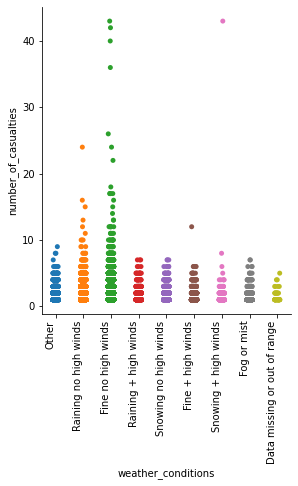

In [19]:
#Q3: What is the relation between the weather condition and the number of casualties in an accident?
dataset.groupby("weather_conditions")["accident_reference"].count()
sns.catplot(data=datasetCopy, x="weather_conditions", y="number_of_casualties")
plt.xticks(rotation=90, ha='right')

**We can conclude that most accidents occured on days in which the weather is fine+no high winds. This is followed by raining weather+high winds.**

In [20]:
dataset.groupby("pedestrian_crossing_human_control")["accident_reference"].count()

pedestrian_crossing_human_control
Control by other authorised person       767
Control by school crossing patrol        386
None within 50 metres                 153261
Name: accident_reference, dtype: int64

(array([153261.,      0.,      0.,      0.,      0.,    767.,      0.,
             0.,      0.,    386.]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <a list of 10 Patch objects>)

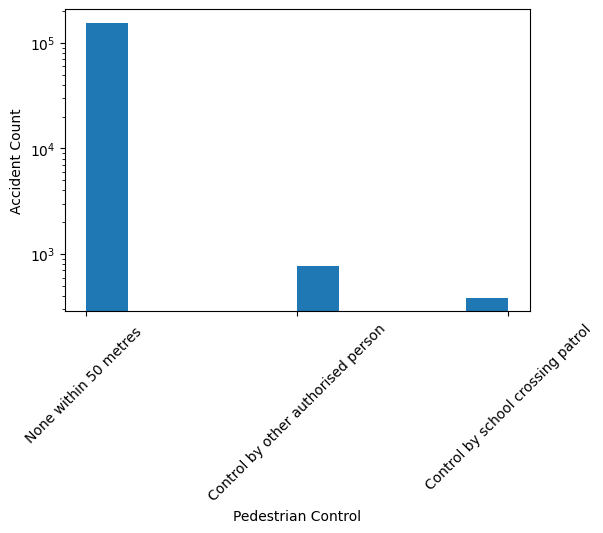

In [21]:
#Q4: Does the availability of pedestrian control affect the rate of accidents?

fig, axs_1 = plt.subplots(1,1,dpi=100)
# axs_1.set_title('Age Histogram')
axs_1.set_xlabel('Pedestrian Control')
axs_1.set_ylabel('Accident Count')
plt.xticks(rotation = 45)
axs_1.set_yscale('log')

#axs_1.set_xlim([35,90]) #zoom in, or show me a certain area on the graph 
axs_1.hist(dataset['pedestrian_crossing_human_control'])

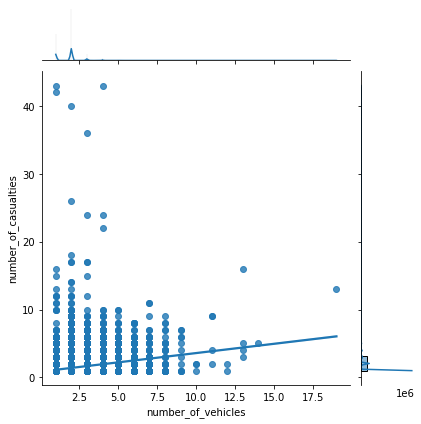

In [22]:
#Q5: Are the number of vehicles and number of casualties related?
sns.jointplot(x='number_of_vehicles',y='number_of_casualties',data=dataset, kind='reg')#draws a regression line representing the 2 variables we are trying to identify

**The rate of increase of the number of vehicles is much greater than that of the number of casualties.**

In [23]:
#dataset.boxplot(column="number_of_casualties", by="accident_severity")


In [24]:
#dataset.boxplot(column="number_of_casualties", by="number_of_vehicles")

(array([132243.,      0.,      0.,      0.,      0.,  20440.,      0.,
             0.,      0.,   1731.]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <a list of 10 Patch objects>)

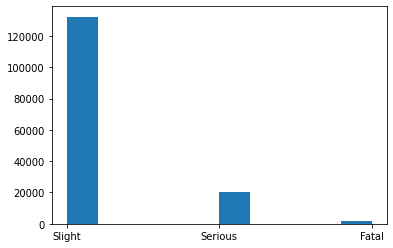

In [25]:
x = dataset['accident_severity']
plt.hist(x)

# 3 - Cleaning Data

In [26]:
df = datasetCopy.drop(['lsoa_of_accident_location','location_easting_osgr','location_northing_osgr'],axis=1)

**Dropping these 3 columns since they can all be derived from the latitude and longitude attributes**

## Observing Missing and duplicate Data

In [27]:
#nullValues = df.isnull()

In [28]:
#df[nullValues]

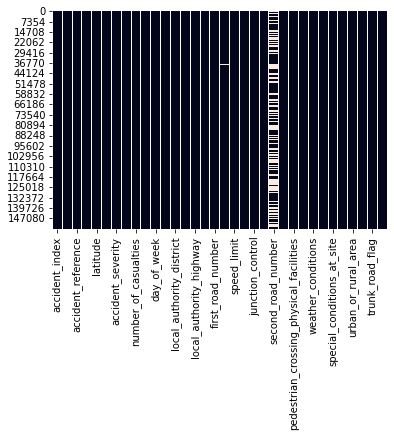

In [29]:
# This heatmap shows that the second road number is the column with the most null values
sns.heatmap(df.isnull(), cbar=False)

In [30]:
df.isna().sum()

accident_index                                     0
accident_year                                      0
accident_reference                                 0
longitude                                          0
latitude                                           0
police_force                                       0
accident_severity                                  0
number_of_vehicles                                 0
number_of_casualties                               0
date                                               0
day_of_week                                        0
time                                               0
local_authority_district                           0
local_authority_ons_district                       0
local_authority_highway                            0
first_road_class                                   0
first_road_number                                  0
road_type                                        704
speed_limit                                   

**Columns with missing values: second_road_number (41%),  road_type,  weather_conditions**

In [31]:
secondRoadNumberNulls = pd.isnull(df["second_road_number"])
 
# filtering data
# displaying data only with second_road_number = NaN
df[secondRoadNumberNulls]

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend
5,201001BS70009,2010,01BS70009,-0.157651,51.484437,Metropolitan Police,Slight,2,1,18/01/2010,Monday,14:59,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3212,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No
10,201001BS70014,2010,01BS70014,-0.187868,51.485178,Metropolitan Police,Slight,2,2,05/01/2010,Tuesday,18:20,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3220,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No
27,201001BS70032,2010,01BS70032,-0.158386,51.494790,Metropolitan Police,Slight,1,1,10/01/2010,Sunday,13:50,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3216,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,Zebra,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,Yes
33,201001BS70040,2010,01BS70040,-0.179097,51.495653,Metropolitan Police,Slight,2,1,19/01/2010,Tuesday,17:30,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,C,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No
37,201001BS70045,2010,01BS70045,-0.195845,51.494743,Metropolitan Police,Slight,1,1,27/01/2010,Wednesday,18:15,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3220,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Other,Wet or damp,None,None,Urban,Yes,Non-trunk,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154401,2010984138310,2010,984138310,-3.217036,54.986031,Dumfries and Galloway,Slight,1,1,21/11/2010,Sunday,00:01,Dumfries and Galloway,Dumfries and Galloway,Dumfries & Galloway,B,721,Single carriageway,60.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - no lighting,Fine no high winds,Wet or damp,None,None,Rural,Yes,Data missing or out of range,Yes
154404,2010984139210,2010,984139210,-3.224229,54.986138,Dumfries and Galloway,Slight,2,1,27/11/2010,Saturday,13:28,Dumfries and Galloway,Dumfries and Galloway,Dumfries & Galloway,B,721,Single carriageway,40.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Other,Wet or damp,None,None,Rural,Yes,Data missing or out of range,Yes
154406,2010984140210,2010,984140210,-3.234813,55.020362,Dumfries and Galloway,Slight,1,1,03/12/2010,Friday,18:56,Dumfries and Galloway,Dumfries and Galloway,Dumfries & Galloway,B,7

In [32]:
df.groupby("second_road_class")["accident_reference"].count()

second_road_class
-1              63523
A               15396
A(M)              127
B                5928
C                7697
Motorway         1100
Unclassified    60643
Name: accident_reference, dtype: int64

In [33]:
df.groupby("second_road_number")["accident_reference"].count()

second_road_number
1.0                                                                                                       404
10.0                                                                                                      125
100.0                                                                                                      16
1000.0                                                                                                     24
1001.0                                                                                                     13
                                                                                                        ...  
991.0                                                                                                       2
993.0                                                                                                       1
994.0                                                                                                

**We can deduce that whenever the second class is -1 the second road number is NaN.**

**Type: MNAR**

**Possible Solution: Impute with 0**

In [34]:
roadTypeNulls = pd.isnull(df["road_type"])
df[roadTypeNulls]

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend
4940,201001GD10564,2010,01GD10564,-0.075465,51.548045,Metropolitan Police,Slight,2,1,30/08/2010,Monday,02:04,Hackney,Hackney,Hackney,A,10,NaN,30.0,T or staggered junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No
21498,201001YE80184,2010,01YE80184,-0.037613,51.613154,Metropolitan Police,Slight,2,2,01/01/2010,Friday,22:13,Enfield,Enfield,Enfield,A,406,NaN,50.0,Roundabout,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Rural,Yes,Non-trunk,No
24167,2010030000078,2010,030000078,-3.521734,54.524584,Cumbria,Slight,2,1,12/01/2010,Tuesday,13:25,Copeland,Copeland,Cumbria,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,NaN,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Frost or ice,None,None,Rural,Yes,Non-trunk,No
24465,2010030000878,2010,030000878,-2.897475,54.298049,Cumbria,Slight,2,1,26/04/2010,Monday,15:12,South Lakeland,South Lakeland,Cumbria,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,NaN,60.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,None,None,Rural,Yes,Non-trunk,No
24541,2010030001059,2010,030001059,-2.721499,54.304802,Cumbria,Slight,2,2,19/05/2010,Wednesday,15:07,South Lakeland,South Lakeland,Cumbria,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,NaN,20.0,Other junction,Give way or uncontrolled,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lighting unknown,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153156,201097QB03310,2010,97QB03310,-4.037893,55.774959,Strathclyde,Slight,1,1,21/10/2010,Thursday,13:53,South Lanarkshire,South Lanarkshire,South Lanarkshire,B,7071,NaN,30.0,T or staggered junction,Auto traffic signal,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,"Pelican, puffin, toucan or similar non-junction pedestrian light crossing",Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Data missing or out of range,No
153441,201097QD01606,2010,97QD01606,-4.132280,55.792321,Strathclyde,Slight,1,1,16/06/2010,Wednesday,10:20,South Lanarkshire,South Lanarkshire,South Lanarkshire,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,NaN,70.0,Other junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official number

**Type: MCAR**

**Possible Solution: Impute with road types of accidents with similar speed limit**

In [35]:
weatherConditionsNulls = pd.isnull(df["weather_conditions"])
df[weatherConditionsNulls]

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend
2928,201001CW12529,2010,01CW12529,-0.129786,51.514211,Metropolitan Police,Slight,1,1,16/11/2010,Tuesday,16:20,Westminster,Westminster,Westminster,A,400,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,C,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,NaN,Dry,None,None,Urban,No,Non-trunk,No
2994,201001CW12610,2010,01CW12610,-0.128914,51.507363,Metropolitan Police,Slight,1,2,01/11/2010,Monday,19:25,Westminster,Westminster,Westminster,A,4,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,A,4.0,None within 50 metres,Zebra,Darkness - lights lit,NaN,Dry,None,None,Urban,No,Non-trunk,No
3101,201001CW12748,2010,01CW12748,-0.144798,51.495925,Metropolitan Police,Slight,1,1,19/12/2010,Sunday,15:29,Westminster,Westminster,Westminster,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,NaN,Wet or damp,None,None,Urban,Yes,Non-trunk,Yes
3104,201001CW12751,2010,01CW12751,-0.132099,51.521083,Metropolitan Police,Slight,1,1,02/12/2010,Thursday,11:30,Camden,Camden,Camden,B,506,Single carriageway,30.0,Crossroads,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,NaN,Dry,None,None,Urban,No,Non-trunk,No
3166,201001CW12862,2010,01CW12862,-0.140935,51.512950,Metropolitan Police,Serious,1,1,23/12/2010,Thursday,17:00,Westminster,Westminster,Westminster,A,4201,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,B,406.0,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,NaN,Wet or damp,None,None,Urban,No,Non-trunk,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153619,201097UA06303,2010,97UA06303,-5.134780,55.546706,Strathclyde,Serious,1,2,28/03/2010,Sunday,04:00,North Ayrshire,North Ayrshire,North Ayrshire,A,841,Single carriageway,60.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - no lighting,NaN,Wet or damp,None,None,Rural,Yes,Data missing or out of range,Yes
153671,201097UC00602,2010,97UC00602,-4.449272,55.601613,Strathclyde,Slight,2,1,04/02/2010,Thursday,09:00,East Ayrshire,East Ayrshire,East Ayrshire,A,71,Single carriageway,30.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,NaN,Wet or damp,None,None,Rural,Yes,Data missing or out of range,No
153767,201097UC40303,2010,97UC40303,-4.255326,55.439236,Strathclyde,Slight,3,1,02/03/2010,Tuesday,08:15,East Ayrshire,East Ayrshire,East Ayrshire,A,76,Single carriageway,60.0,Not at junction or within 20 metres,Data missing or out of range,-1,NaN,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,NaN,Wet or damp,None,None,Rural

**The weather conditions are NaN with no explained reason.**

**Type: MCAR**

**Possible Solution: Impute using the weather_conditions attribute of accidents having the same date, time, and location**



In [36]:
for i in df:
  print(df.groupby(""+i)["accident_reference"].count())
  print("-------------------------------------------------------------------------------------------------------")

accident_index
201001BS70003    1
201001BS70004    1
201001BS70006    1
201001BS70007    1
201001BS70008    1
                ..
2010984142510    1
2010984143110    1
2010984144210    1
2010984144310    1
2010984144410    1
Name: accident_reference, Length: 154414, dtype: int64
-------------------------------------------------------------------------------------------------------
accident_year
2010    154414
Name: accident_reference, dtype: int64
-------------------------------------------------------------------------------------------------------
accident_reference
01BS70003    1
01BS70004    1
01BS70006    1
01BS70007    1
01BS70008    1
            ..
984142510    1
984143110    1
984144210    1
984144310    1
984144410    1
Name: accident_reference, Length: 154414, dtype: int64
-------------------------------------------------------------------------------------------------------
longitude
-7.516225    1
-7.504121    1
-7.498973    1
-7.444088    1
-7.362204    1
            ..
 1

In [37]:
result = df.duplicated(subset=['accident_reference'])
df[result]

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend


In [38]:
# How many unique values for a particular column?
df.loc[:, "accident_reference"].value_counts(dropna=False)

01BS70003    1
43N279100    1
43N280060    1
43N280100    1
43N280110    1
            ..
130005063    1
130005064    1
130005065    1
130005066    1
984144410    1
Name: accident_reference, Length: 154414, dtype: int64

**Using the accident reference (unique identifier) to check if a record of an accident is duplicated.
There are no duplicate accident records.** 

## Handling Missing data

**No columns will be dropped since the biggest number of null values (which is in the second_road_number column) is 41.27% of the column values.
We only drop a column if more than half of its values are missing.**

In [39]:
df.isna().sum()

accident_index                                     0
accident_year                                      0
accident_reference                                 0
longitude                                          0
latitude                                           0
police_force                                       0
accident_severity                                  0
number_of_vehicles                                 0
number_of_casualties                               0
date                                               0
day_of_week                                        0
time                                               0
local_authority_district                           0
local_authority_ons_district                       0
local_authority_highway                            0
first_road_class                                   0
first_road_number                                  0
road_type                                        704
speed_limit                                   

In [40]:
# Imputing the second_road_number with 'zero' since it's written in the dataset that roads which do not have official numbers are recorded as 'zero'
updated_df = df.copy()
updated_df['second_road_number']=updated_df['second_road_number'].fillna('zero')

In [41]:
updated_df.isna().sum()

accident_index                                    0
accident_year                                     0
accident_reference                                0
longitude                                         0
latitude                                          0
police_force                                      0
accident_severity                                 0
number_of_vehicles                                0
number_of_casualties                              0
date                                              0
day_of_week                                       0
time                                              0
local_authority_district                          0
local_authority_ons_district                      0
local_authority_highway                           0
first_road_class                                  0
first_road_number                                 0
road_type                                       704
speed_limit                                       0
junction_det

**There are no longer any null values for the second_road_number attribute.**

In [42]:
df.groupby(["road_type","speed_limit"]).size()

road_type           speed_limit
Dual carriageway    20.0              24
                    30.0            6495
                    40.0            3606
                    50.0            1901
                    60.0            1010
                    70.0            9907
One way street      20.0             126
                    30.0            2931
                    40.0              41
                    50.0              11
                    60.0              44
Roundabout          20.0              41
                    30.0            6463
                    40.0            1559
                    50.0             436
                    60.0            1255
                    70.0             665
Single carriageway  10.0               1
                    15.0               1
                    20.0            1322
                    30.0           83414
                    40.0            7221
                    50.0            2678
                    60.0 

In [43]:
# Imputing the road_type with the mode value
updated_df['road_type'] = updated_df['road_type'].fillna(updated_df['road_type'].mode()[0])

In [44]:
updated_df.isna().sum()

accident_index                                    0
accident_year                                     0
accident_reference                                0
longitude                                         0
latitude                                          0
police_force                                      0
accident_severity                                 0
number_of_vehicles                                0
number_of_casualties                              0
date                                              0
day_of_week                                       0
time                                              0
local_authority_district                          0
local_authority_ons_district                      0
local_authority_highway                           0
first_road_class                                  0
first_road_number                                 0
road_type                                         0
speed_limit                                       0
junction_det

**The null values for the road_type attribute have now been removed.**

In [45]:
# Imputing the weather_conditions with the mode value
updated_df['weather_conditions'] = updated_df['weather_conditions'].fillna(updated_df['weather_conditions'].mode()[0])

In [46]:
updated_df.isna().sum()

accident_index                                 0
accident_year                                  0
accident_reference                             0
longitude                                      0
latitude                                       0
police_force                                   0
accident_severity                              0
number_of_vehicles                             0
number_of_casualties                           0
date                                           0
day_of_week                                    0
time                                           0
local_authority_district                       0
local_authority_ons_district                   0
local_authority_highway                        0
first_road_class                               0
first_road_number                              0
road_type                                      0
speed_limit                                    0
junction_detail                                0
junction_control    

**The null values for the weather_conditions attribute have now been removed.**

In [47]:
weatherAndRoad = updated_df.groupby(["road_surface_conditions","weather_conditions"]).size()

In [48]:
weatherAndRoad2 = weatherAndRoad.to_frame(name='count').reset_index()

In [49]:
weatherAndRoad2

,road_surface_conditions,weather_conditions,count
0,Data missing or out of range,Fine no high winds,166
1,Data missing or out of range,Other,1
2,Dry,Data missing or out of range,48
3,Dry,Fine + high winds,735
4,Dry,Fine no high winds,102900
5,Dry,Fog or mist,87
6,Dry,Other,563
7,Dry,Raining + high winds,10
8,Dry,Raining no high winds,120
9,Dry,Snowing no high winds,12


In [50]:
weather = weatherAndRoad2['road_surface_conditions'].unique()
final = pd.DataFrame()
for index in weather:
  weatherAndRoad3 = weatherAndRoad2[weatherAndRoad2['road_surface_conditions']==index]
  weatherAndRoad5 = weatherAndRoad3[(weatherAndRoad3['count']==(weatherAndRoad3['count'].max()))]
  final = final.append(weatherAndRoad5)

In [51]:
final

,road_surface_conditions,weather_conditions,count
0,Data missing or out of range,Fine no high winds,166
4,Dry,Fine no high winds,102900
15,Flood over 3cm. deep,Raining no high winds,75
20,Frost or ice,Fine no high winds,4355
34,Snow,Snowing no high winds,1986
37,Wet or damp,Fine no high winds,17897


In [52]:
# my_series = final.squeeze()

# test = updated_df
# test = updated_df.set_index(['road_surface_conditions']).fillna(final.set_index(['road_surface_conditions'])).reset_index()

indices=[]
count = 1
for i in final['road_surface_conditions']:
  indices.append(count)
  count = count + 1
final['index'] = indices

final


,road_surface_conditions,weather_conditions,count,index
0,Data missing or out of range,Fine no high winds,166,1
4,Dry,Fine no high winds,102900,2
15,Flood over 3cm. deep,Raining no high winds,75,3
20,Frost or ice,Fine no high winds,4355,4
34,Snow,Snowing no high winds,1986,5
37,Wet or damp,Fine no high winds,17897,6


In [53]:
lookup = pd.Series(['Fine no high winds','Fine no high winds','Raining no high winds','Fine no high winds','Snowing no high winds','Fine no high winds'], index = range(1,7))
lookup

1       Fine no high winds
2       Fine no high winds
3    Raining no high winds
4       Fine no high winds
5    Snowing no high winds
6       Fine no high winds
dtype: object

In [54]:
updated_df.loc[updated_df['weather_conditions'].isnull(),'weather_conditions'] = updated_df['road_surface_conditions'].map(lookup)

In [55]:
updated_df.isna().sum()

accident_index                                 0
accident_year                                  0
accident_reference                             0
longitude                                      0
latitude                                       0
police_force                                   0
accident_severity                              0
number_of_vehicles                             0
number_of_casualties                           0
date                                           0
day_of_week                                    0
time                                           0
local_authority_district                       0
local_authority_ons_district                   0
local_authority_highway                        0
first_road_class                               0
first_road_number                              0
road_type                                      0
speed_limit                                    0
junction_detail                                0
junction_control    

## Findings and conclusions

Cleaning the data involved:
1. Dropping the 'lsoa_of_accident_location','location_easting_osgr', and 'location_northing_osgr' columns since they can be obtained from the longitude and latitude attributes
2. Checking to see if there are any duplicate records using the 'accident_reference' attribute since it is unique for every accident
3. Observing the missing data using the isna() function. There were 3 attributes with missing values
4. Handling the missing values with imputation. The 'second_road_number' was imputed with 'zero', the 'road_type' and 'weather_conditions' were imputed with the mode values

## Observing outliers

In [56]:
# check outliers:
# - if mean significantly below median, we have outliers on the left of chart.
# - if mean significantly above median, we have outliers on the right of chart.

df.describe().loc[["mean", "50%"], :]

,accident_year,longitude,latitude,number_of_vehicles,number_of_casualties,speed_limit
mean,2010.0,-1.424687,52.578706,1.82238,1.351225,38.884266
50%,2010.0,-1.375859,52.278924,2.00000,1.000000,30.000000


In [57]:
# Plotting the boxplots of the numeric attributes; we excluded the accident_year column since it is the same for all accidents (2010)
toPlot=[]
for columnName, columnValues in updated_df.items():
  if (is_numeric_dtype(df[columnName]) and columnName != "accident_year"):
    toPlot.append(columnName)

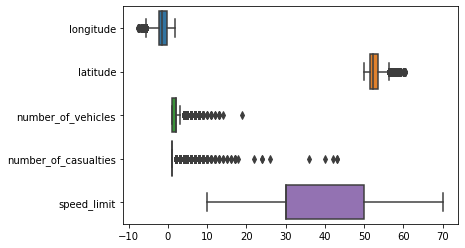

In [58]:
sns.boxplot(data=updated_df[toPlot], orient="h")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


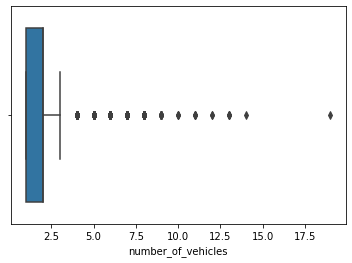

In [59]:
sns.boxplot(df['number_of_vehicles'])


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


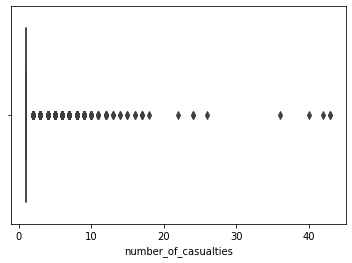

In [60]:
sns.boxplot(df['number_of_casualties'])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


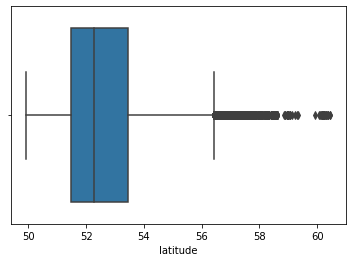

In [61]:
sns.boxplot(df['latitude'])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


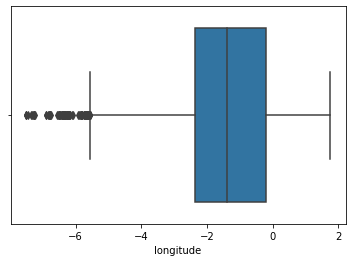

In [62]:
sns.boxplot(df['longitude'])

In [63]:
# Using the IQR method to detect outliers
outliers=[]
lowerUpper=[]
for i in df:
  if (is_numeric_dtype(df[i]) and columnName != "accident_year"):
    # sns.boxplot(data=df[i+''], orient="h")
    Q1 = df[i+''].quantile(0.25)
    Q3 = df[i+''].quantile(0.75)
    IQR = Q3 - Q1
    # print(IQR)
    cut_off = IQR * 1.5
    lower = Q1 - cut_off
    upper =  Q3 + cut_off
    df1 = df[df[i+'']> upper]
    df2 = df[df[i+''] < lower]
    if (df1.shape[0]+ df2.shape[0] >0):
      outliers.append(i)
      lowerUpper.append([i,lower,upper])

    print('Total number of outliers for ', i+' are: ', df1.shape[0]+ df2.shape[0])

Total number of outliers for  accident_year are:  0
Total number of outliers for  longitude are:  128
Total number of outliers for  latitude are:  2255
Total number of outliers for  number_of_vehicles are:  3317
Total number of outliers for  number_of_casualties are:  36037
Total number of outliers for  speed_limit are:  0


In [64]:
lowerUpper

[['longitude', -5.564932875, 2.9996421250000007],
 ['latitude', 48.53534675, 56.417336750000004],
 ['number_of_vehicles', -0.5, 3.5],
 ['number_of_casualties', 1.0, 1.0]]

**The rule is that any value below Q1-1.5*IQR or above Q3+1.5*IQR is an outlier.**

**We first calculated the IQR for every numeric column. After that, we calculated the cut_off values. We appended these values for each column in a list, along with the corresponding column name.**


## Handling outliers

In [65]:
# df = pd.DataFrame(np.random.randn(100, 3))
# from scipy import stats
# df[(np.abs(stats.zscore(df)) < 3).all(axis=1)]

# For each column, it first computes the Z-score of each value in the column, relative to the column mean and standard deviation.
# It then takes the absolute Z-score because the direction does not matter, only if it is below the threshold.
# all(axis=1) ensures that for each row, all column satisfy the constraint.
# Finally, the result of this condition is used to index the dataframe.

df_filtered = updated_df

#Looping over all the columns that contain outliers (except number_of_casualties since its lower bound = upper bound) and removing the rows that contain these outliers
for i in lowerUpper:
  if (i[0] != 'number_of_casualties'):
    df_filtered = updated_df[(updated_df[i[0]] < i[2]) & (updated_df[i[0]] > i[1])]

#handling the outliers in the number_of_casualties column
df_filtered = df_filtered[(df_filtered[lowerUpper[3][0]] == 1)]

df_filtered

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend
0,201001BS70003,2010,01BS70003,-0.164002,51.484087,Metropolitan Police,Slight,2,1,11/01/2010,Monday,07:30,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,B,302,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Other,Wet or damp,None,None,Urban,Yes,Non-trunk,No
1,201001BS70004,2010,01BS70004,-0.195273,51.509212,Metropolitan Police,Slight,1,1,11/01/2010,Monday,18:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,A,4204.0,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No
2,201001BS70006,2010,01BS70006,-0.203110,51.507804,Metropolitan Police,Slight,2,1,12/01/2010,Tuesday,10:22,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,B,450.0,None within 50 metres,Pedestrian phase at traffic signal junction,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No
3,201001BS70007,2010,01BS70007,-0.198858,51.513314,Metropolitan Police,Slight,2,1,02/01/2010,Saturday,21:21,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Roundabout,30.0,Mini-roundabout,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,Yes
4,201001BS70008,2010,01BS70008,-0.175802,51.484361,Metropolitan Police,Slight,2,1,04/01/2010,Monday,20:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3217,Single carriageway,30.0,Crossroads,Auto traffic signal,A,3220.0,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154407,2010984140610,2010,984140610,-3.387060,55.162156,Dumfries and Galloway,Serious,1,1,04/12/2010,Saturday,03:04,Dumfries and Galloway,Dumfries and Galloway,Dumfries & Galloway,A(M),74,Dual carriageway,70.0,Not at junction or within 20 metres,Data missing or out of range,-1,zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - no lighting,Fine no high winds,Wet or damp,None,None,Rural,Yes,Data missing or out of range,Yes
154408,2010984141510,2010,984141510,-3.218610,54.986374,Dumfries and Galloway,Slight,2,1,08/12/2010,Wednesday,20:53,Dumfries and Galloway,Dumfries and Galloway,Dumfries & Galloway,B,721,Single carriageway,60.0,T or staggered junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness

## Findings and conclusions

To observe the outliers, we used the IQR method. There was a total of 4 attributes that contain outliers.
To deal with the outliers, we removed each record that has an outlier value for any of those 4 columns.

# 4 - Data transformation

## 4.1 - Discretization

In [66]:
df_filtered.dtypes

accident_index                                  object
accident_year                                    int64
accident_reference                              object
longitude                                      float64
latitude                                       float64
police_force                                    object
accident_severity                               object
number_of_vehicles                               int64
number_of_casualties                             int64
date                                            object
day_of_week                                     object
time                                            object
local_authority_district                        object
local_authority_ons_district                    object
local_authority_highway                         object
first_road_class                                object
first_road_number                               object
road_type                                       object
speed_limi

In [67]:
df_filtered['date']= pd.to_datetime(df_filtered['date'])


In [68]:
df_filtered.dtypes

accident_index                                         object
accident_year                                           int64
accident_reference                                     object
longitude                                             float64
latitude                                              float64
police_force                                           object
accident_severity                                      object
number_of_vehicles                                      int64
number_of_casualties                                    int64
date                                           datetime64[ns]
day_of_week                                            object
time                                                   object
local_authority_district                               object
local_authority_ons_district                           object
local_authority_highway                                object
first_road_class                                       object
first_ro

In [69]:
df_filtered.head()

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend
0,201001BS70003,2010,01BS70003,-0.164002,51.484087,Metropolitan Police,Slight,2,1,2010-11-01,Monday,07:30,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,B,302,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Other,Wet or damp,None,None,Urban,Yes,Non-trunk,No
1,201001BS70004,2010,01BS70004,-0.195273,51.509212,Metropolitan Police,Slight,1,1,2010-11-01,Monday,18:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,A,4204.0,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No
2,201001BS70006,2010,01BS70006,-0.203110,51.507804,Metropolitan Police,Slight,2,1,2010-12-01,Tuesday,10:22,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,B,450.0,None within 50 metres,Pedestrian phase at traffic signal junction,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No
3,201001BS70007,2010,01BS70007,-0.198858,51.513314,Metropolitan Police,Slight,2,1,2010-02-01,Saturday,21:21,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Roundabout,30.0,Mini-roundabout,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,Yes
4,201001BS70008,2010,01BS70008,-0.175802,51.484361,Metropolitan Police,Slight,2,1,2010-04-01,Monday,20:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3217,Single carriageway,30.0,Crossroads,Auto traffic signal,A,3220.0,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No


In [70]:
df_filtered['Week number'] = df_filtered['date'].dt.week

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  """Entry point for launching an IPython kernel.


In [71]:
df_filtered.head()

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend,Week number
0,201001BS70003,2010,01BS70003,-0.164002,51.484087,Metropolitan Police,Slight,2,1,2010-11-01,Monday,07:30,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,B,302,Single carriageway,30.0,T or staggered junction,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Other,Wet or damp,None,None,Urban,Yes,Non-trunk,No,44
1,201001BS70004,2010,01BS70004,-0.195273,51.509212,Metropolitan Police,Slight,1,1,2010-11-01,Monday,18:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,A,4204.0,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No,44
2,201001BS70006,2010,01BS70006,-0.203110,51.507804,Metropolitan Police,Slight,2,1,2010-12-01,Tuesday,10:22,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,402,Single carriageway,30.0,T or staggered junction,Auto traffic signal,B,450.0,None within 50 metres,Pedestrian phase at traffic signal junction,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,No,48
3,201001BS70007,2010,01BS70007,-0.198858,51.513314,Metropolitan Police,Slight,2,1,2010-02-01,Saturday,21:21,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,Roundabout,30.0,Mini-roundabout,Give way or uncontrolled,Unclassified,first_road_class is C or Unclassified. These roads do not have official numbers so recorded as zero,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,Yes,5
4,201001BS70008,2010,01BS70008,-0.175802,51.484361,Metropolitan Police,Slight,2,1,2010-04-01,Monday,20:35,Kensington and Chelsea,Kensington and Chelsea,Kensington and Chelsea,A,3217,Single carriageway,30.0,Crossroads,Auto traffic signal,A,3220.0,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,No,13


## 4.11 - Findings and conclusions

We converted the 'date' attribute to 'datetime'. We then obtained the week number from the obtained datetime, and added it as a new column to our dataframe.

## 4.2 - Encoding

In [72]:
df_filtered.dtypes

accident_index                                         object
accident_year                                           int64
accident_reference                                     object
longitude                                             float64
latitude                                              float64
police_force                                           object
accident_severity                                      object
number_of_vehicles                                      int64
number_of_casualties                                    int64
date                                           datetime64[ns]
day_of_week                                            object
time                                                   object
local_authority_district                               object
local_authority_ons_district                           object
local_authority_highway                                object
first_road_class                                       object
first_ro

In [73]:
#copy the dataset so as not to change in the original dataset
# datasetEnc = df_filtered.select_dtypes(include = ['object']).copy()

datasetEnc = df_filtered.copy()

#convert column to category
# datasetEnc["accident_severity"] = datasetEnc["accident_severity"].astype('category')
# datasetEnc.dtypes

In [74]:
#Label Encoding
#datasetEnc["accident_severity_cat"] = datasetEnc["accident_severity"].cat.codes

In [75]:
datasetEnc.dtypes
#accident_severity_cat -> int8

accident_index                                         object
accident_year                                           int64
accident_reference                                     object
longitude                                             float64
latitude                                              float64
police_force                                           object
accident_severity                                      object
number_of_vehicles                                      int64
number_of_casualties                                    int64
date                                           datetime64[ns]
day_of_week                                            object
time                                                   object
local_authority_district                               object
local_authority_ons_district                           object
local_authority_highway                                object
first_road_class                                       object
first_ro

In [76]:
# # Loop over columns and check which columns have distinct values < 7 
# # Columns with distinct values < 7 will be encoded
# columnsToEncode = []
# for columnName, columnValues in datasetEnc.items():
#   if(datasetEnc[columnName].unique().size < 8):
#     columnsToEncode.append(columnName)
# print(columnsToEncode)

In [77]:
#adding a new col!

# data = {'Name': ['Jai', 'Princi', 'Gaurav', 'Anuj'],
#         'Height': [5.1, 6.2, 5.1, 5.2],
#         'Qualification': ['Msc', 'MA', 'Msc', 'Msc']}

# df = pd.DataFrame(data)        
# dt = ['12','11','1','23']
# df['DateTime'] = dt
# print(df)

In [78]:
# Loop over columns and check which columns are of data type 'object' 

mappings = []

columnsToEncode = []
le = preprocessing.LabelEncoder()
for columnName, columnValues in datasetEnc.items():
  if (datasetEnc.dtypes[columnName] == object and columnName != 'time'):
    # columnsToEncode.append(columnName)
    datasetEnc[columnName] = le.fit_transform(datasetEnc[columnName])

    if (columnName != "accident_reference"): 
      le_name_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
      print(le_name_mapping)
      mappings.append(le_name_mapping)

    # mapped = le.fit_transform(datasetEnc[columnName])
    # print(le.inverse_transform(mapped))

# print(columnsToEncode)
print(mappings)

{'201001BS70003': 0, '201001BS70004': 1, '201001BS70006': 2, '201001BS70007': 3, '201001BS70008': 4, '201001BS70009': 5, '201001BS70010': 6, '201001BS70011': 7, '201001BS70012': 8, '201001BS70013': 9, '201001BS70015': 10, '201001BS70018': 11, '201001BS70019': 12, '201001BS70020': 13, '201001BS70021': 14, '201001BS70023': 15, '201001BS70025': 16, '201001BS70026': 17, '201001BS70027': 18, '201001BS70028': 19, '201001BS70029': 20, '201001BS70030': 21, '201001BS70031': 22, '201001BS70032': 23, '201001BS70033': 24, '201001BS70034': 25, '201001BS70036': 26, '201001BS70038': 27, '201001BS70039': 28, '201001BS70040': 29, '201001BS70042': 30, '201001BS70043': 31, '201001BS70044': 32, '201001BS70045': 33, '201001BS70046': 34, '201001BS70048': 35, '201001BS70049': 36, '201001BS70050': 37, '201001BS70052': 38, '201001BS70053': 39, '201001BS70058': 40, '201001BS70059': 41, '201001BS70060': 42, '201001BS70061': 43, '201001BS70062': 44, '201001BS70063': 45, '201001BS70065': 46, '201001BS70066': 47, '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [79]:
# ids = le.fit_transform(datasetEnc['road_type'])
# mapping = dict(zip(le.classes_, range(len(le.classes_))))
# all([mapping[x] for x in le.inverse_transform(ids)] == ids)

In [80]:
# le = preprocessing.LabelEncoder()
# le.fit(datasetEnc['accident_severity'])
# le_name_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
# print(le_name_mapping)

In [81]:
# convert column to category, then replace column values with the numerical values from the label encoding
# for i in columnsToEncode:
#   datasetEnc[i] = datasetEnc[i].astype('category')
#   datasetEnc[i] = datasetEnc[i].cat.codes

In [82]:
datasetEnc.dtypes

accident_index                                          int64
accident_year                                           int64
accident_reference                                      int64
longitude                                             float64
latitude                                              float64
police_force                                            int64
accident_severity                                       int64
number_of_vehicles                                      int64
number_of_casualties                                    int64
date                                           datetime64[ns]
day_of_week                                             int64
time                                                   object
local_authority_district                                int64
local_authority_ons_district                            int64
local_authority_highway                                 int64
first_road_class                                        int64
first_ro

In [83]:
datasetEnc.head()

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend,Week number
0,0,2010,0,-0.164002,51.484087,29,2,2,1,2010-11-01,1,07:30,166,168,90,2,858,3,30.0,8,3,6,2465,2,2,4,4,5,3,1,1,1,1,0,44
1,1,2010,1,-0.195273,51.509212,29,2,1,1,2010-11-01,1,18:35,166,168,90,0,1276,3,30.0,8,1,1,1198,2,3,1,6,5,3,1,1,1,1,0,44
2,2,2010,2,-0.203110,51.507804,29,2,2,1,2010-12-01,5,10:22,166,168,90,0,1276,3,30.0,8,1,3,1339,2,3,4,2,1,3,1,1,1,1,0,48
3,3,2010,3,-0.198858,51.513314,29,2,2,1,2010-02-01,2,21:21,166,168,90,5,3255,2,30.0,1,3,6,2465,2,2,1,2,1,3,1,1,1,1,1,5
4,4,2010,4,-0.175802,51.484361,29,2,2,1,2010-04-01,1,20:35,166,168,90,0,1044,3,30.0,0,1,1,847,2,2,1,2,5,3,1,1,1,1,0,13


In [84]:
mappings

[{'201001BS70003': 0,
  '201001BS70004': 1,
  '201001BS70006': 2,
  '201001BS70007': 3,
  '201001BS70008': 4,
  '201001BS70009': 5,
  '201001BS70010': 6,
  '201001BS70011': 7,
  '201001BS70012': 8,
  '201001BS70013': 9,
  '201001BS70015': 10,
  '201001BS70018': 11,
  '201001BS70019': 12,
  '201001BS70020': 13,
  '201001BS70021': 14,
  '201001BS70023': 15,
  '201001BS70025': 16,
  '201001BS70026': 17,
  '201001BS70027': 18,
  '201001BS70028': 19,
  '201001BS70029': 20,
  '201001BS70030': 21,
  '201001BS70031': 22,
  '201001BS70032': 23,
  '201001BS70033': 24,
  '201001BS70034': 25,
  '201001BS70036': 26,
  '201001BS70038': 27,
  '201001BS70039': 28,
  '201001BS70040': 29,
  '201001BS70042': 30,
  '201001BS70043': 31,
  '201001BS70044': 32,
  '201001BS70045': 33,
  '201001BS70046': 34,
  '201001BS70048': 35,
  '201001BS70049': 36,
  '201001BS70050': 37,
  '201001BS70052': 38,
  '201001BS70053': 39,
  '201001BS70058': 40,
  '201001BS70059': 41,
  '201001BS70060': 42,
  '201001BS70061': 43

In [85]:
pd.DataFrame({}).to_csv("/content/new.csv")

In [86]:
file = open('/content/new.csv', 'w+', newline ='')

In [87]:
with file:   
    write = csv.writer(file)
    write.writerows(mappings)

In [88]:
read_new = pd.read_csv("/content/new.csv",index_col=0)

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning: Columns (3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253

In [89]:
read_new.head()

,201001BS70004,201001BS70006,201001BS70007,201001BS70008,201001BS70009,201001BS70010,201001BS70011,201001BS70012,201001BS70013,201001BS70015,201001BS70018,201001BS70019,201001BS70020,201001BS70021,201001BS70023,201001BS70025,201001BS70026,201001BS70027,201001BS70028,201001BS70029,201001BS70030,201001BS70031,201001BS70032,201001BS70033,201001BS70034,201001BS70036,201001BS70038,201001BS70039,201001BS70040,201001BS70042,201001BS70043,201001BS70044,201001BS70045,201001BS70046,201001BS70048,201001BS70049,201001BS70050,201001BS70052,201001BS70053,201001BS70058,201001BS70059,201001BS70060,201001BS70061,201001BS70062,201001BS70063,201001BS70065,201001BS70066,201001BS70068,201001BS70069,201001BS70070,201001BS70071,201001BS70072,201001BS70075,201001BS70076,201001BS70077,201001BS70078,201001BS70079,201001BS70080,201001BS70082,201001BS70083,201001BS70084,201001BS70085,201001BS70086,201001BS70088,201001BS70089,201001BS70090,201001BS70091,201001BS70092,201001BS70094,201001BS70096,201001BS70097,201001BS70098,201001BS70099,201001BS70100,201001BS70101,201001BS70102,201001BS70103,201001BS70104,201001BS70105,201001BS70106,201001BS70107,201001BS70108,201001BS70109,201001BS70110,201001BS70111,201001BS70112,201001BS70113,201001BS70114,201001BS70115,201001BS70116,201001BS70118,201001BS70119,201001BS70120,201001BS70121,201001BS70123,201001BS70124,201001BS70125,201001BS70127,201001BS70130,201001BS70131,201001BS70133,201001BS70135,201001BS70137,201001BS70138,201001BS70140,201001BS70142,201001BS70143,201001BS70145,201001BS70146,201001BS70147,201001BS70148,201001BS70150,201001BS70151,201001BS70152,201001BS70153,201001BS70154,201001BS70155,201001BS70156,201001BS70158,201001BS70159,201001BS70160,201001BS70161,201001BS70162,201001BS70163,201001BS70164,201001BS70166,201001BS70167,201001BS70168,201001BS70169,201001BS70172,201001BS70174,201001BS70175,201001BS70177,201001BS70180,201001BS70181,201001BS70183,201001BS70184,201001BS70185,201001BS70186,201001BS70187,201001BS70188,201001BS70189,201001BS70191,201001BS70192,201001BS70193,201001BS70194,201001BS70195,201001BS70196,201001BS70197,201001BS70198,201001BS70200,201001BS70202,201001BS70204,201001BS70205,201001BS70206,201001BS70207,201001BS70208,201001BS70209,201001BS70210,201001BS70212,201001BS70213,201001BS70214,201001BS70215,201001BS70217,201001BS70218,201001BS70219,201001BS70220,201001BS70221,201001BS70222,201001BS70225,201001BS70226,201001BS70227,201001BS70228,201001BS70229,201001BS70230,201001BS70232,201001BS70233,201001BS70234,201001BS70235,201001BS70237,201001BS70238,201001BS70239,201001BS70241,201001BS70242,201001BS70244,201001BS70245,201001BS70246,201001BS70247,201001BS70249,201001BS70250,201001BS70251,201001BS70252,201001BS70254,201001BS70255,201001BS70257,201001BS70258,201001BS70259,201001BS70260,201001BS70261,201001BS70262,201001BS70263,201001BS70264,201001BS70265,201001BS70266,201001BS70267,201001BS70268,201001BS70269,201001BS70270,201001BS70272,201001BS70274,201001BS70276,201001BS70277,201001BS70278,201001BS70279,201001BS70280,201001BS70281,201001BS70283,201001BS70284,201001BS70288,201001BS70289,201001BS70291,201001BS70292,201001BS70294,201001BS70295,201001BS70296,201001BS70298,201001BS70300,201001BS70301,201001BS70302,201001BS70303,201001BS70304,201001BS70305,201001BS70306,201001BS70307,201001BS70308,201001BS70309,201001BS70310,201001BS70312,201001BS70313,201001BS70314,201001BS70315,201001BS70316,201001BS70318,201001BS70319,201001BS70320,201001BS70323,201001BS70324,201001BS70325,201001BS70326,201001BS70327,201001BS70328,201001BS70330,201001BS70331,201001BS70332,201001BS70333,201001BS70335,201001BS70336,201001BS70337,201001BS70338,201001BS70339,201001BS70340,201001BS70341,201001BS70342,201001BS70343,201001BS70344,201001BS70345,201001BS70347,201001BS70348,201001BS70350,201001BS70351,201001BS70352,201001BS70353,201001BS70354,201001BS70355,201001BS70356,201001BS70357,201001BS70358,201001BS70359,201001BS70360,201001BS70361,201001BS70362,201001BS70363,201001BS70364,201001BS70365,201001BS70367,201001BS7

## 4.22 - Findings and conclusions



We looped over the dataframe, and any attribute of datatype object was added to the list of items to be encoded.
After doing the encoding, we created a dictionary that maps the original values to the corresponding encoded values.
We then created a new empty csv file, and wrote to it the list of mappings.
As shown above, all the different values for an attribute are displayed, and the encoded equivalent for each value is the column index of that value.
For instance, the accident_severity attribute was encoded as follows: Fatal:0 , Serious:1 , Slight:2 .

## 4.3 - Normalisation 

Cant use categorization collumn

Using Min Max Scaler

In [112]:
# copy the data
# df_min_max_scaled = datasetEnc.copy()
  
# # apply normalization techniques
# for column in df_min_max_scaled.items():
#     if (column != "Timestamp"):
#       df_min_max_scaled[column] = (df_min_max_scaled[column].astype(int) - df_min_max_scaled[column].min().astype(int) ) / (df_min_max_scaled[column].max().astype(int) - df_min_max_scaled[column].min().astype(int))    
  
# # view normalized data
# print(df_min_max_scaled)

In [113]:
# import matplotlib.pyplot as plt
# df_min_max_scaled.plot(kind = 'bar')

In [93]:
datasetEnc.head()

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend,Week number
0,0,2010,0,-0.164002,51.484087,29,2,2,1,2010-11-01,1,07:30,166,168,90,2,858,3,30.0,8,3,6,2465,2,2,4,4,5,3,1,1,1,1,0,44
1,1,2010,1,-0.195273,51.509212,29,2,1,1,2010-11-01,1,18:35,166,168,90,0,1276,3,30.0,8,1,1,1198,2,3,1,6,5,3,1,1,1,1,0,44
2,2,2010,2,-0.203110,51.507804,29,2,2,1,2010-12-01,5,10:22,166,168,90,0,1276,3,30.0,8,1,3,1339,2,3,4,2,1,3,1,1,1,1,0,48
3,3,2010,3,-0.198858,51.513314,29,2,2,1,2010-02-01,2,21:21,166,168,90,5,3255,2,30.0,1,3,6,2465,2,2,1,2,1,3,1,1,1,1,1,5
4,4,2010,4,-0.175802,51.484361,29,2,2,1,2010-04-01,1,20:35,166,168,90,0,1044,3,30.0,0,1,1,847,2,2,1,2,5,3,1,1,1,1,0,13


In [94]:
datasetEnc.columns

Index(['accident_index', 'accident_year', 'accident_reference', 'longitude',
       'latitude', 'police_force', 'accident_severity', 'number_of_vehicles',
       'number_of_casualties', 'date', 'day_of_week', 'time',
       'local_authority_district', 'local_authority_ons_district',
       'local_authority_highway', 'first_road_class', 'first_road_number',
       'road_type', 'speed_limit', 'junction_detail', 'junction_control',
       'second_road_class', 'second_road_number',
       'pedestrian_crossing_human_control',
       'pedestrian_crossing_physical_facilities', 'light_conditions',
       'weather_conditions', 'road_surface_conditions',
       'special_conditions_at_site', 'carriageway_hazards',
       'urban_or_rural_area', 'did_police_officer_attend_scene_of_accident',
       'trunk_road_flag', 'weekend', 'Week number'],
      dtype='object')

In [114]:
X2_Data = datasetEnc[['accident_index','accident_reference','first_road_number','second_road_number']]

In [115]:
from sklearn.preprocessing import MinMaxScaler

In [116]:
scaler = MinMaxScaler()
scaler.fit(X2_Data)
Normalizeddata=scaler.transform(X2_Data)

In [117]:
Normalizeddata

array([[0.00000000e+00, 0.00000000e+00, 2.63594470e-01, 9.99594485e-01],
       [8.55607653e-06, 8.55607653e-06, 3.92012289e-01, 4.85806975e-01],
       [1.71121531e-05, 1.71121531e-05, 3.92012289e-01, 5.42984590e-01],
       ...,
       [9.99982888e-01, 9.99982888e-01, 1.00000000e+00, 1.00000000e+00],
       [9.99991444e-01, 9.99991444e-01, 8.90322581e-01, 9.27412814e-01],
       [1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 9.99594485e-01]])

Using Lambda function

In [118]:
normaldata2=X2_Data.apply(lambda x: (x-x.min(axis=0) ) / (x.max(axis=0) - x.min(axis=0)))

In [120]:
normaldata2

,accident_index,accident_reference,first_road_number,second_road_number
0,0.000000,0.000000,0.263594,0.999594
1,0.000009,0.000009,0.392012,0.485807
2,0.000017,0.000017,0.392012,0.542985
3,0.000026,0.000026,1.000000,0.999594
4,0.000034,0.000034,0.320737,0.343471
...,...,...,...,...
154407,0.999966,0.999966,0.895238,1.000000
154408,0.999974,0.999974,0.890015,0.999594
154409,0.999983,0.999983,1.000000,1.000000
154410,0.999991,0.999991,0.890323,0.927413


## 4.31 - Findings and conclusions

For the normalization, we chose 4 columns ['accident_index','accident_reference','first_road_number','second_road_number] since they have very different ranges. Normalisation is done to unify the scale, without affecting the range differences.

## 4.4 - Adding more columns

In [121]:
from datetime import time

In [122]:
TimeSlots=[]
for i in datasetEnc['time']:
  if time.fromisoformat(i).hour >= 0 and time.fromisoformat(i).hour < 3 :
    TimeSlots.append('MidNight')
  elif time.fromisoformat(i).hour >= 3 and time.fromisoformat(i).hour < 6:
    TimeSlots.append('Dawn')
  elif time.fromisoformat(i).hour >= 6 and time.fromisoformat(i).hour < 9:
    TimeSlots.append('Early Morning')
  elif time.fromisoformat(i).hour >= 9 and time.fromisoformat(i).hour < 12:
    TimeSlots.append('Morning')
  elif time.fromisoformat(i).hour >= 12 and time.fromisoformat(i).hour < 15:
    TimeSlots.append('AfterNoon')
  elif time.fromisoformat(i).hour >= 15 and time.fromisoformat(i).hour < 18:
    TimeSlots.append('Dusk')
  elif time.fromisoformat(i).hour >= 18 and time.fromisoformat(i).hour < 21:
    TimeSlots.append('Night')
  else :
    TimeSlots.append('LateNight')

datasetEnc['TimeSlots'] = TimeSlots
#dataset.head()
t = pd.DataFrame(datasetEnc)
t[['time', 'TimeSlots']]

,time,TimeSlots
0,07:30,Early Morning
1,18:35,Night
2,10:22,Morning
3,21:21,LateNight
4,20:35,Night
...,...,...
154407,03:04,Dawn
154408,20:53,Night
154409,13:45,AfterNoon
154410,02:30,MidNight


In [ ]:
# "weekend" column was already added to help us in visualizing the days on which accidents happened the most (weekends vs weekdays)

# weekEnd=[]
# for i in dataset['day_of_week']:
#   if i == 'Saturday' or i =='Sunday':
#     weekEnd.append('Yes')
#   else:
#     weekEnd.append('No')
# datasetCopy['weekend'] = weekEnd

## 4.41 - Findings and concluisons

We added 2 new columns: 'weekend' and 'Timeslots'.

The 'weekend' attribute determines whether the accident happened on a weekend or not.
The 'Timeslots' attribute divides a day into 8 slots: 'MidNight' , 'Dawn' , 'Early Morning' , 'Morning' , 'Afternoon' , 'Dusk' , 'Night'.

## 4.5 - Csv file for lookup

Already handled in 4.2 when doing the label encoding. We created a csv file ('new.csv') which contains all the mappings of the encoded values to the original values.

## 5- Exporting the dataframe to a csv file or parquet

In [123]:
datasetEnc.to_csv('/content/finaldf.csv')

In [124]:
read_finaldf = pd.read_csv("/content/finaldf.csv",index_col=0)

In [125]:
read_finaldf.head()

,accident_index,accident_year,accident_reference,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,weekend,Week number,TimeSlots
0,0,2010,0,-0.164002,51.484087,29,2,2,1,2010-11-01,1,07:30,166,168,90,2,858,3,30.0,8,3,6,2465,2,2,4,4,5,3,1,1,1,1,0,44,Early Morning
1,1,2010,1,-0.195273,51.509212,29,2,1,1,2010-11-01,1,18:35,166,168,90,0,1276,3,30.0,8,1,1,1198,2,3,1,6,5,3,1,1,1,1,0,44,Night
2,2,2010,2,-0.203110,51.507804,29,2,2,1,2010-12-01,5,10:22,166,168,90,0,1276,3,30.0,8,1,3,1339,2,3,4,2,1,3,1,1,1,1,0,48,Morning
3,3,2010,3,-0.198858,51.513314,29,2,2,1,2010-02-01,2,21:21,166,168,90,5,3255,2,30.0,1,3,6,2465,2,2,1,2,1,3,1,1,1,1,1,5,LateNight
4,4,2010,4,-0.175802,51.484361,29,2,2,1,2010-04-01,1,20:35,166,168,90,0,1044,3,30.0,0,1,1,847,2,2,1,2,5,3,1,1,1,1,0,13,Night


In [126]:
read_finaldf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116877 entries, 0 to 154411
Data columns (total 36 columns):
 #   Column                                       Non-Null Count   Dtype  
---  ------                                       --------------   -----  
 0   accident_index                               116877 non-null  int64  
 1   accident_year                                116877 non-null  int64  
 2   accident_reference                           116877 non-null  int64  
 3   longitude                                    116877 non-null  float64
 4   latitude                                     116877 non-null  float64
 5   police_force                                 116877 non-null  int64  
 6   accident_severity                            116877 non-null  int64  
 7   number_of_vehicles                           116877 non-null  int64  
 8   number_of_casualties                         116877 non-null  int64  
 9   date                                         116877 non-nul